## UniVI manuscript – Commonly-used data integration tool benchmarking test for Genome Research manuscript revisions
### UniVI benchmark (Multiome PBMC): Merging and plotting PyTorch and R tool CV sweep metrics

Andrew Ashford, Pathways + Omics Group, Oregon Health & Science University, Portland, OR – 1/25/2026


This notebook:
- loads summary tables output by the PyTorch and R integration method CV sweep notebooks
- generates plots of each of the metrics of all combines tools used for Multiome method comparison evaluations
  
Manuscript: https://www.biorxiv.org/content/10.1101/2025.02.28.640429v1.full
Code: https://github.com/Ashford-A/UniVI


#### Import modules and specify file paths

In [1]:
import numpy as np
import pandas as pd
from pathlib import Path

# -----------------------------
# Paths
# -----------------------------
#P_CV_LONG = Path("/home/groups/precepts/ashforda/runs_multiome_py_1-24-2026/runs/cv_sweep_py_1-24-2026/cv_sweep_long.csv")
P_CV_LONG = Path("/home/groups/precepts/ashforda/runs_multiome_py_1-31-2026/runs/cv_sweep_py_1-31-2026/cv_sweep_long.csv")
#P_CV_RUNS = Path("/home/groups/precepts/ashforda/univi_bench/runs_multiome_R_1-30-2026_WORKING/runs/cv_sweep_R_1-30-2026_WORKING/cv_runs.tsv")
P_CV_RUNS = Path("/home/groups/precepts/ashforda/univi_bench/runs_multiome_R_1-31-2026/runs/cv_sweep_R_1-31-2026/cv_runs.tsv")

OUT_DIR = Path("./Figure_9-method_comparison/violin_plots")
OUT_DIR.mkdir(parents=True, exist_ok=True)


#### Load tables

In [2]:
print("Reading:", P_CV_LONG)
print("Reading:", P_CV_RUNS)

df_long = pd.read_csv(P_CV_LONG)
df_runs = pd.read_csv(P_CV_RUNS, sep="\t")

print("df_long:", df_long.shape, "cols=", len(df_long.columns))
print("df_runs:", df_runs.shape, "cols=", len(df_runs.columns))


Reading: /home/groups/precepts/ashforda/runs_multiome_py_1-31-2026/runs/cv_sweep_py_1-31-2026/cv_sweep_long.csv
Reading: /home/groups/precepts/ashforda/univi_bench/runs_multiome_R_1-31-2026/runs/cv_sweep_R_1-31-2026/cv_runs.tsv
df_long: (135, 58) cols= 58
df_runs: (90, 68) cols= 68


#### Harmonize method tables

In [3]:
# -----------------------------
# Standardization maps
# -----------------------------
# If df_runs ever contains verbose names, this maps them to short keys.
# If df_runs already contains short keys (like seurat_wnn), it will pass through unchanged.
RUNS_METHOD_MAP = {
    "Seurat/Signac WNN (Seurat 5.4.0; Signac 1.16.0)": "seurat_wnn",
    "Seurat CCA RNA vs GeneActivity (Seurat 5.4.0; Signac 1.16.0)": "seurat_cca",
    "Seurat v5 Bridge (Seurat 5.4.0; Signac 1.16.0; SeuratObject 5.3.0)": "seurat_bridge",
    "Harmony-modality (harmony 1.2.4)": "harmony",
    "LIGER gene-activity iNMF (rliger 2.2.1; SeuratObject 5.3.0)": "liger",
    "MOFA2 on PCA+LSI views (MOFA2 1.16.0)": "mofa2",
}

# short keys -> display names
DISPLAY_NAME = {
    "univi": "UniVI",
    "scglue": "scGLUE",
    "scjoint": "scJoint",
    "cobolt": "Cobolt",
    "multivi": "MultiVI",
    "peakvi": "PeakVI",
    "scmomat": "scMoMaT",
    "deepcca": "DeepCCA",
    "multimap": "MultiMap",

    "harmony": "Harmony",

    # robust: accept both keys if they appear
    "seurat_wnn": "SeuratWNN",
    "wnn": "SeuratWNN",

    "seurat_bridge": "SeuratBridge",
    "seurat_cca": "SeuratCCA",
    "liger": "LIGER",
    "mofa2": "MOFA2",
}

# raw column names -> standardized names (apply to BOTH tables)
METRIC_RENAME = {
    "PAIR(test)/FOSCTTM_mean": "FOSCTTM_mean_test",
    "PAIR(test)/FOSCTTM_MRR": "FOSCTTM_mrr_mean_test",
    "PAIR(test)/FOSCTTM_Recall@1": "FOSCTTM_recall@1_mean_test",
    "PAIR(test)/FOSCTTM_Recall@10": "FOSCTTM_recall@10_mean_test",
    "PAIR(test)/FOSCTTM_Recall@25": "FOSCTTM_recall@25_mean_test",
    "PAIR(test)/FOSCTTM_Recall@50": "FOSCTTM_recall@50_mean_test",
    "PAIR(test)/FOSCTTM_Recall@100": "FOSCTTM_recall@100_mean_test",
    "PAIR(test)/Label transfer acc mean": "label_transfer_acc_mean_test",
    "PAIR(test)/Label transfer macroF1 mean": "label_transfer_macroF1_mean_test",

    "MIX(test)/Mixing score": "mixing_score_test",

    "Fused kNN acc": "fused_knn_acc_test",
    "Fused kNN macroF1": "fused_knn_macroF1_test",
    "Fused kNN balanced acc": "fused_knn_balanced_acc_test",

    "Fused(fusedZ,test) silhouette": "fused_silhouette_test",
    "Fused(fusedZ,test) label purity": "fused_knn_label_purity_test",
    "Fused(fusedZ,test) k-means ARI": "fused_kmeans_ari_test",
    "Fused(fusedZ,test) k-means NMI": "fused_kmeans_nmi_test",
}

METHOD_ORDER = [
    "UniVI","scGLUE","Cobolt","MultiVI","scJoint","PeakVI","scMoMaT","MultiMap","DeepCCA",
    "Harmony","MOFA2","LIGER","SeuratWNN","SeuratBridge","SeuratCCA",
]


In [4]:
# -----------------------------
# Helpers
# -----------------------------
def _clean_str(x):
    if pd.isna(x):
        return np.nan
    return str(x).strip()

def _clean_lower(x):
    if pd.isna(x):
        return np.nan
    return str(x).strip().lower()

def standardize_method_series(s: pd.Series) -> pd.Series:
    """
    Works for:
      - already-short keys like seurat_wnn
      - verbose strings that appear in RUNS_METHOD_MAP
    """
    m = s.map(_clean_str)

    # Map verbose -> short if applicable
    m2 = m.map(RUNS_METHOD_MAP)
    m = m2.fillna(m)

    # Lowercase keys
    m = m.map(_clean_lower)

    # Pretty display names if known
    m = m.map(DISPLAY_NAME).fillna(m)
    return m

def ensure_status(df: pd.DataFrame, failed_col="failed") -> pd.DataFrame:
    df = df.copy()
    if "status" in df.columns:
        df["status"] = df["status"].astype(str)
        return df
    if failed_col in df.columns:
        df["status"] = np.where(df[failed_col].astype(bool), "failed", "ok")
    else:
        df["status"] = "ok"
    return df

def to_long(df: pd.DataFrame, metric_cols: list[str], source_label: str) -> pd.DataFrame:
    keep = ["method"] + [m for m in metric_cols if m in df.columns]
    out = df[keep].copy()
    for m in keep[1:]:
        out[m] = pd.to_numeric(out[m], errors="coerce")
    out = out.melt(id_vars=["method"], var_name="metric", value_name="value")
    out["source"] = source_label
    out = out.dropna(subset=["method", "value"])
    return out


In [5]:
# -----------------------------
# Standardize BOTH tables
# -----------------------------
df_long_std = df_long.copy()
df_runs_std = df_runs.copy()

# rename metrics on both so they can match 1:1
df_long_std = df_long_std.rename(columns=METRIC_RENAME)
df_runs_std = df_runs_std.rename(columns=METRIC_RENAME)

# standardize method names on both
if "method" in df_long_std.columns:
    df_long_std["method"] = standardize_method_series(df_long_std["method"])
else:
    df_long_std["method"] = "unknown"

if "method" in df_runs_std.columns:
    df_runs_std["method"] = standardize_method_series(df_runs_std["method"])
else:
    df_runs_std["method"] = "unknown"

# status on both
df_long_std = ensure_status(df_long_std)
df_runs_std = ensure_status(df_runs_std)

# keep only successful
df_long_ok = df_long_std[df_long_std["status"].str.lower().eq("ok")].copy()
df_runs_ok = df_runs_std[df_runs_std["status"].str.lower().eq("ok")].copy()

# keep only methods that exist
METHOD_ORDER_USE = [m for m in METHOD_ORDER if m in set(pd.concat([df_long_ok["method"], df_runs_ok["method"]]).unique())]
print("Final METHOD_ORDER:", METHOD_ORDER_USE)


Final METHOD_ORDER: ['UniVI', 'scGLUE', 'Cobolt', 'MultiVI', 'scJoint', 'PeakVI', 'scMoMaT', 'MultiMap', 'DeepCCA', 'Harmony', 'MOFA2', 'LIGER', 'SeuratWNN', 'SeuratBridge', 'SeuratCCA']


In [6]:
# -----------------------------
# Pick metrics: union of numeric-like cols across both
# -----------------------------
exclude_cols = {
    "method","seed","fold","status","error","failed","transductive","uses_labels",
    "n_train","n_val","n_test","latent_dim","reason","n_features","k_view","lr","dropout",
    "weight_decay","batch_size","max_epochs","patience","reg","best_val","nbatches",
    "n_latent","n_latent_requested","joint_dim_returned","atac_tfidf",
    "patched_scipy_sparse_vstack_scoped","latent_cap","lr_used","source","skipped",
    "__eval_error__","PAIR(test)/FOSCTTM_n_eval",
}

def numeric_metric_cols(df: pd.DataFrame) -> list[str]:
    cols = []
    for c in df.columns:
        if c in exclude_cols:
            continue
        if pd.api.types.is_numeric_dtype(df[c]):
            cols.append(c)
        else:
            v = pd.to_numeric(df[c], errors="coerce")
            if v.notna().any():
                cols.append(c)
    return cols

metric_cols = sorted(set(numeric_metric_cols(df_long_ok)).union(numeric_metric_cols(df_runs_ok)))

headline = [
    "FOSCTTM_mean_test",
    "label_transfer_acc_mean_test",
    "label_transfer_macroF1_mean_test",
    "mixing_score_test",
    "fused_knn_acc_test",
    "fused_kmeans_nmi_test",
    "fused_kmeans_ari_test",
    "fused_silhouette_test",
]
metric_cols = [m for m in headline if m in metric_cols] + [m for m in metric_cols if m not in headline]

print("Detected metrics:", len(metric_cols))
print(metric_cols[:40])


Detected metrics: 44
['FOSCTTM_mean_test', 'label_transfer_acc_mean_test', 'label_transfer_macroF1_mean_test', 'mixing_score_test', 'fused_knn_acc_test', 'fused_kmeans_nmi_test', 'fused_kmeans_ari_test', 'fused_silhouette_test', 'ATAC(test)/kNN acc', 'ATAC(test)/kNN balanced acc', 'ATAC(test)/kNN macroF1', 'ATAC(test)/kmeans ARI', 'ATAC(test)/kmeans NMI', 'ATAC(test)/label purity', 'ATAC(test)/silhouette', 'FOSCTTM_mrr_mean_test', 'FOSCTTM_recall@100_mean_test', 'FOSCTTM_recall@10_mean_test', 'FOSCTTM_recall@1_mean_test', 'FOSCTTM_recall@25_mean_test', 'FOSCTTM_recall@50_mean_test', 'MIX(test)/Fused k-means ARI', 'MIX(test)/Fused k-means NMI', 'MIX(test)/Fused label purity', 'MIX(test)/Fused silhouette', 'MIX(test)/Mixing score (ATAC)', 'MIX(test)/Mixing score (MOD)', 'MIX(test)/Mixing score (RNA)', 'RNA(test)/kNN acc', 'RNA(test)/kNN balanced acc', 'RNA(test)/kNN macroF1', 'RNA(test)/kmeans ARI', 'RNA(test)/kmeans NMI', 'RNA(test)/label purity', 'RNA(test)/silhouette', 'align_weight',

In [7]:
# -----------------------------
# Build one long plotting table
# -----------------------------
long_py = to_long(df_long_ok, metric_cols, source_label="py")
long_r  = to_long(df_runs_ok, metric_cols, source_label="r")
df_plot = pd.concat([long_py, long_r], ignore_index=True)


In [8]:
print(df_plot.groupby(["source","method"]).size().sort_values(ascending=False).head(30))
print("Metrics shared by both sources:", len(set(long_py.metric) & set(long_r.metric)))


source  method      
r       SeuratBridge    540
        SeuratWNN       540
        SeuratCCA       540
        MOFA2           540
        LIGER           540
        Harmony         540
py      DeepCCA         435
        MultiMap        390
        Cobolt          360
        UniVI           360
        MultiVI         360
        scJoint         360
        scGLUE          360
        PeakVI          120
        scMoMaT         120
dtype: int64
Metrics shared by both sources: 22


In [9]:
print("py runs per method:")
print(df_long_ok.groupby("method").size().sort_values(ascending=False))

print("\nr runs per method:")
print(df_runs_ok.groupby("method").size().sort_values(ascending=False))


py runs per method:
method
Cobolt      15
DeepCCA     15
MultiMap    15
MultiVI     15
PeakVI      15
UniVI       15
scGLUE      15
scJoint     15
scMoMaT     15
dtype: int64

r runs per method:
method
Harmony         15
LIGER           15
MOFA2           15
SeuratBridge    15
SeuratCCA       15
SeuratWNN       15
dtype: int64


In [10]:
m = "FOSCTTM_mean_test"  # change as needed
tmp = df_plot[df_plot["metric"] == m]
print(tmp.groupby(["source","method"]).size().sort_values(ascending=False))


source  method      
py      Cobolt          15
        DeepCCA         15
        MultiMap        15
        MultiVI         15
        UniVI           15
        scGLUE          15
        scJoint         15
r       Harmony         15
        LIGER           15
        MOFA2           15
        SeuratBridge    15
        SeuratCCA       15
        SeuratWNN       15
dtype: int64


In [11]:
import matplotlib as mpl
import matplotlib.pyplot as plt

# Bigger default figure size + readable fonts
mpl.rcParams["figure.figsize"] = (16, 14)    # default size for all new figures
mpl.rcParams["figure.dpi"] = 300             # notebook display dpi
mpl.rcParams["savefig.dpi"] = 300            # saved image dpi (paper-ready)
mpl.rcParams["font.size"] = 12
mpl.rcParams["axes.titlesize"] = 14
mpl.rcParams["axes.labelsize"] = 13
mpl.rcParams["xtick.labelsize"] = 11
mpl.rcParams["ytick.labelsize"] = 11
mpl.rcParams["legend.fontsize"] = 11
mpl.rcParams["lines.linewidth"] = 1.5


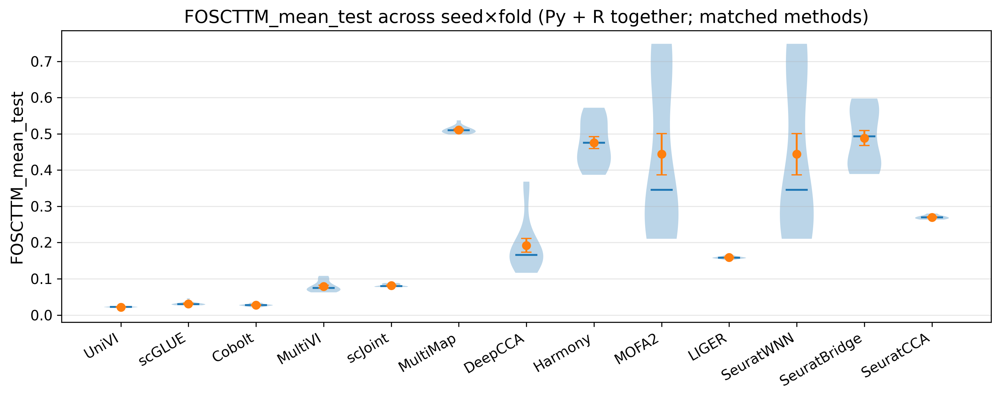

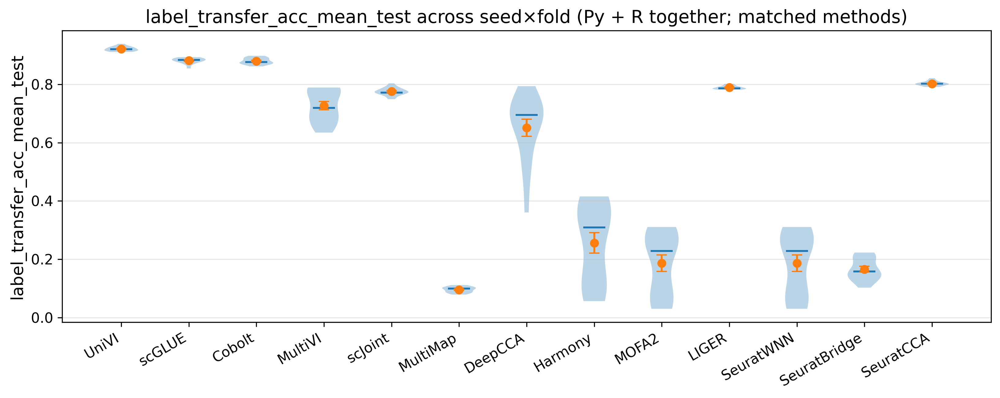

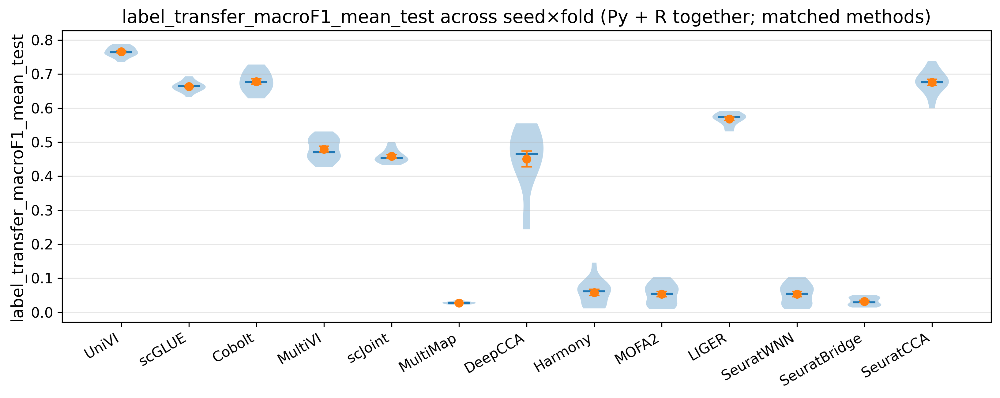

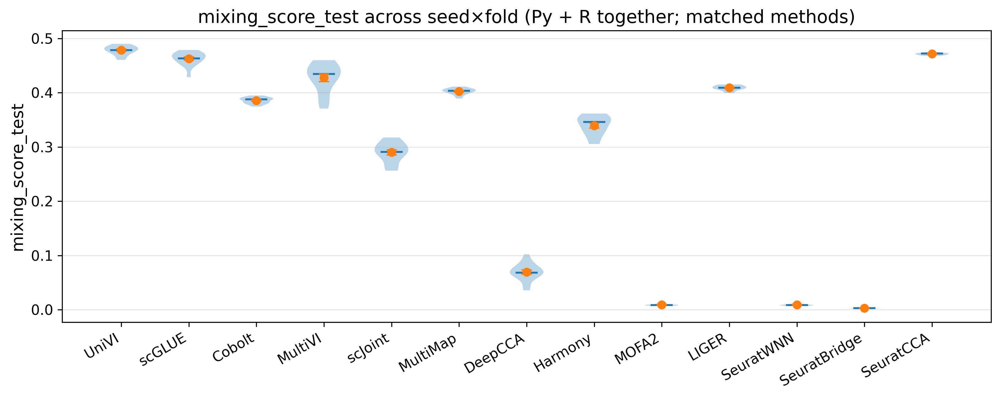

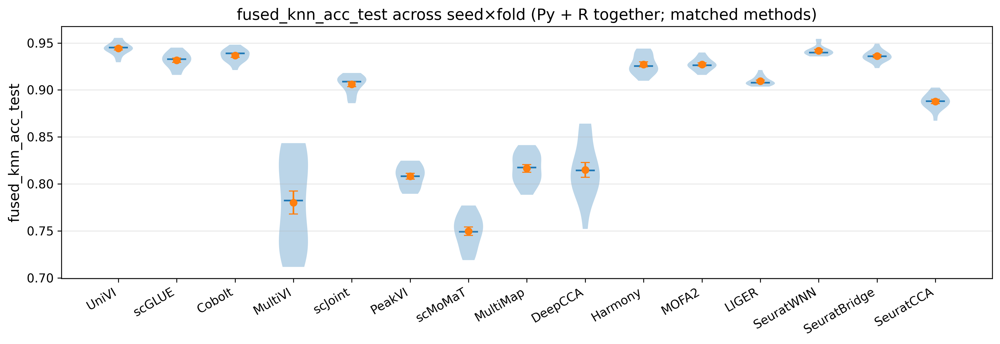

...

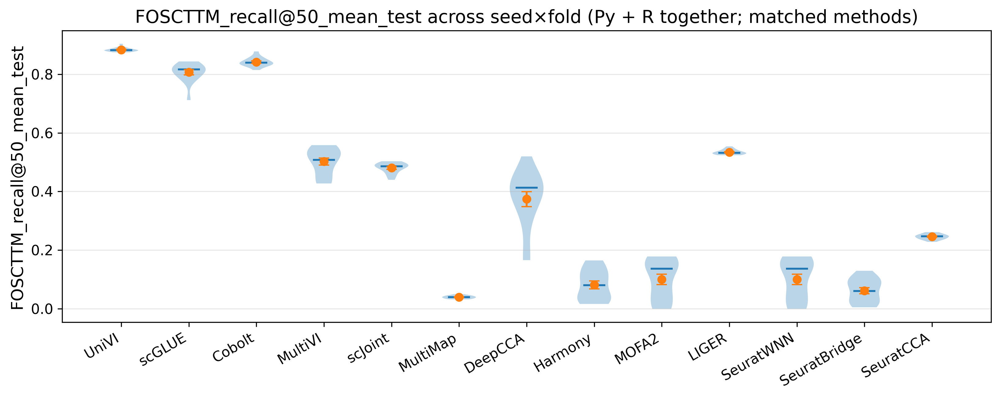

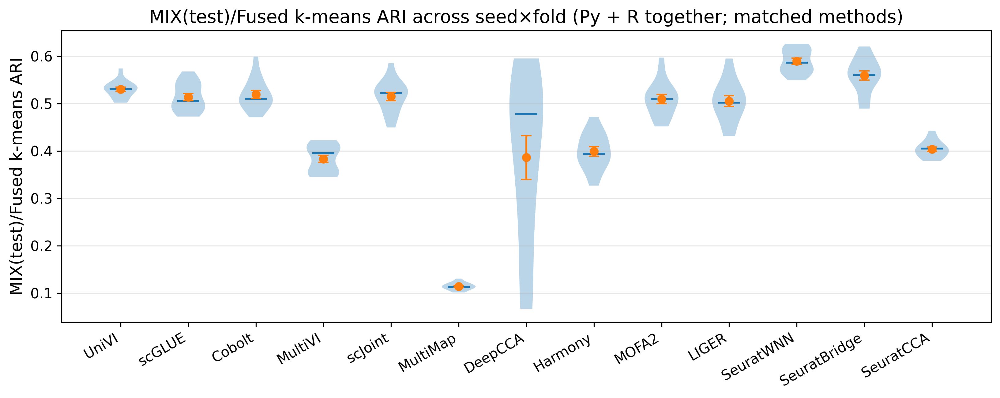

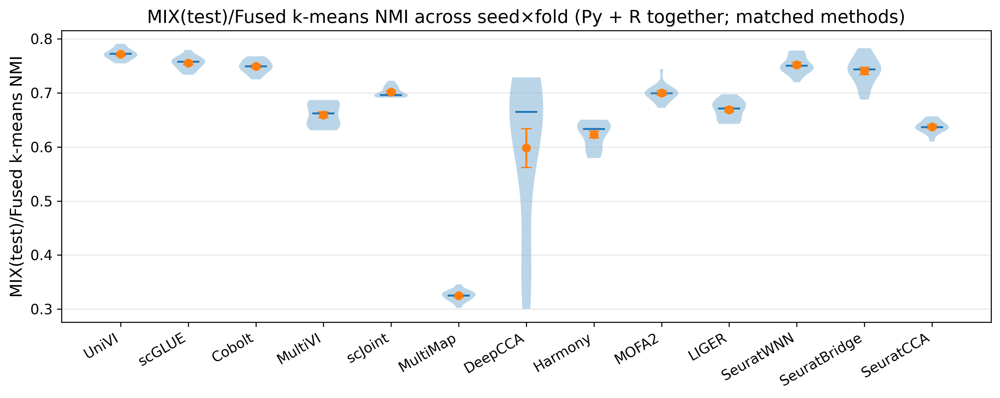

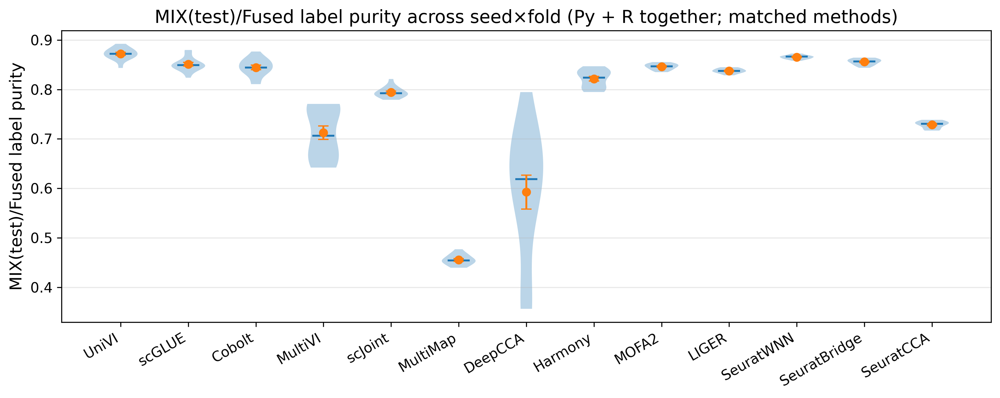

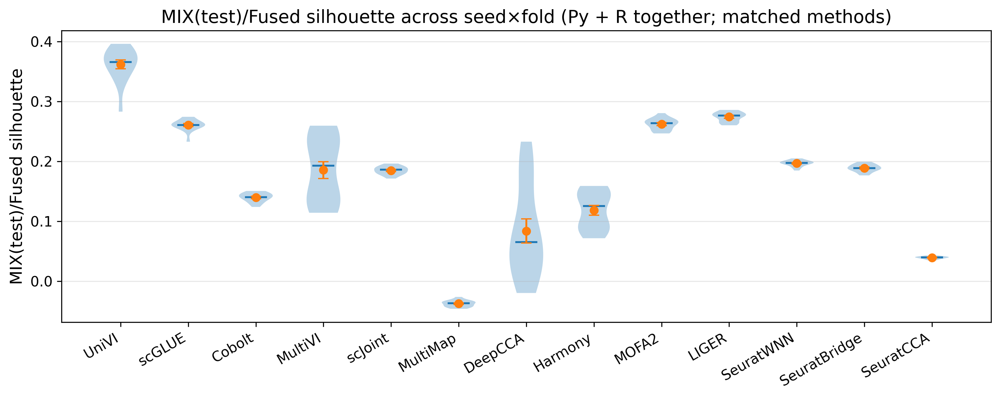

[plot] no data for metric=MIX(test)/Mixing score (ATAC)


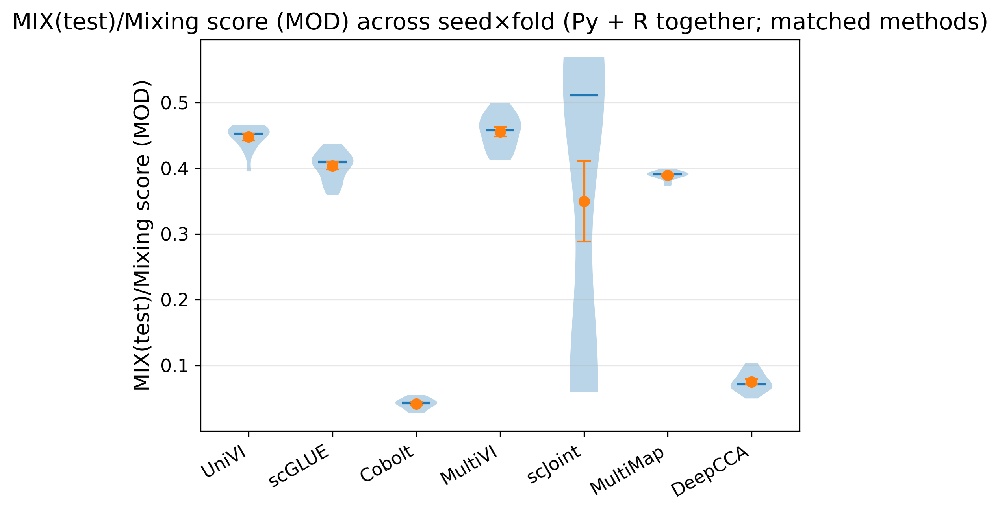

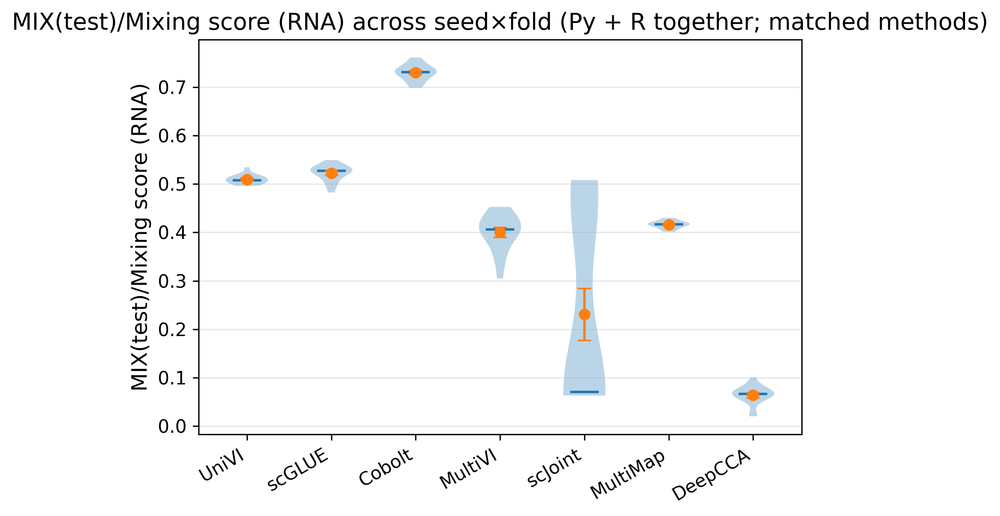

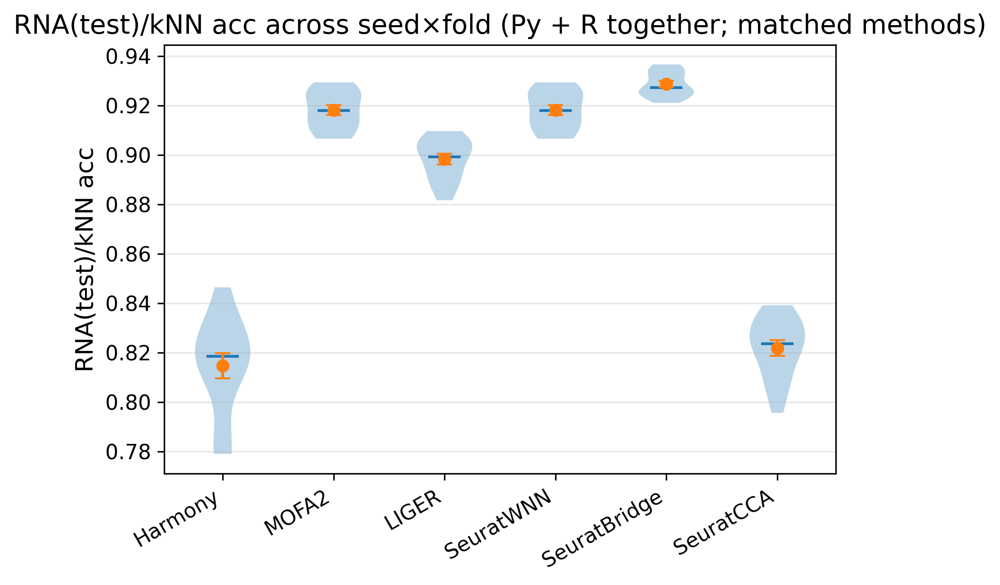

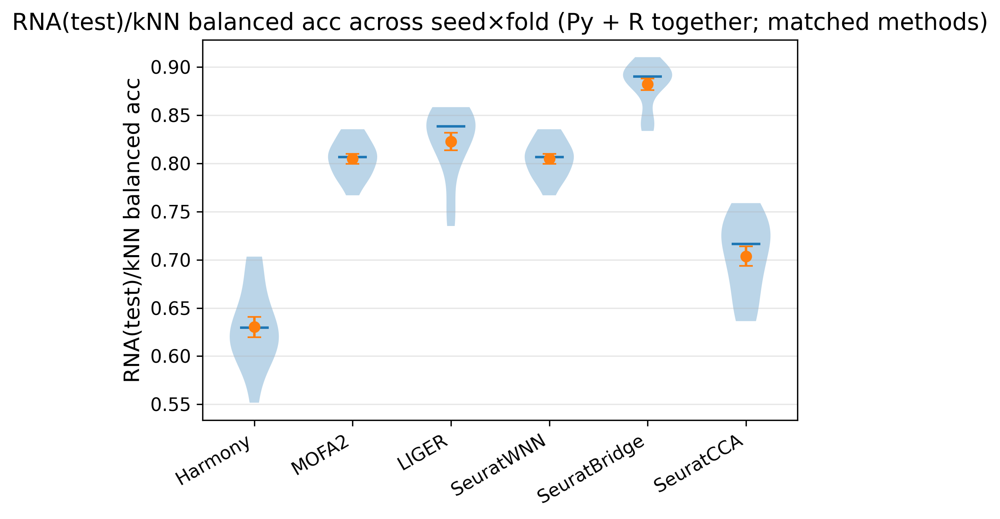

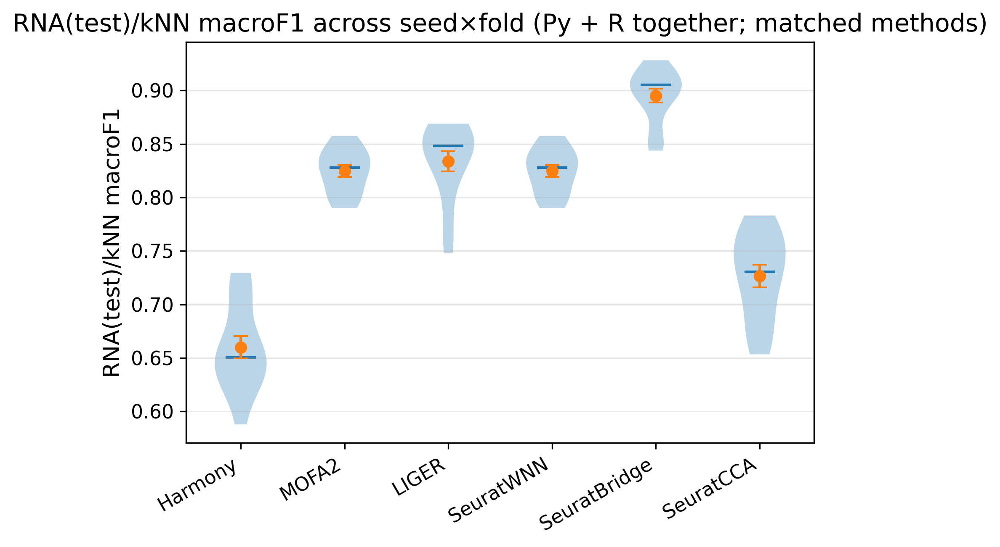

...

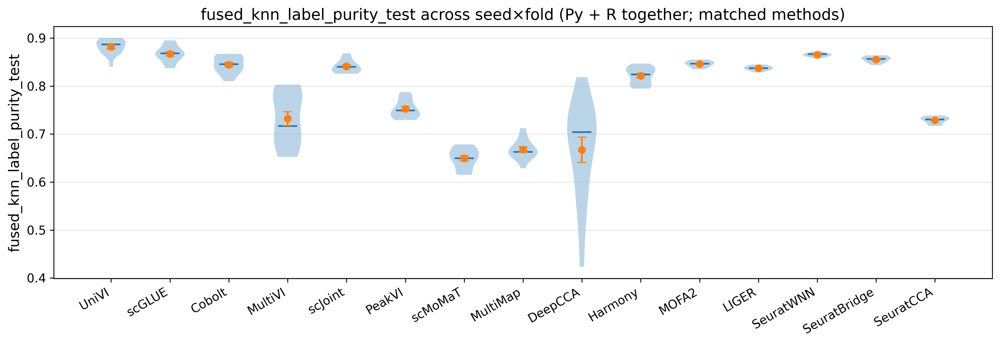

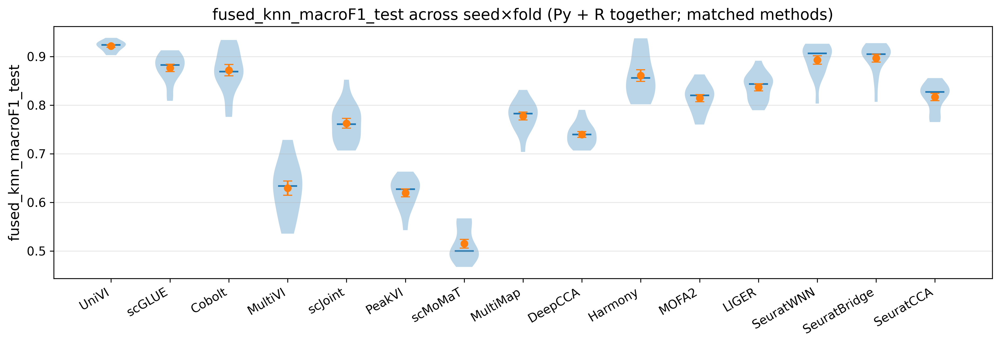

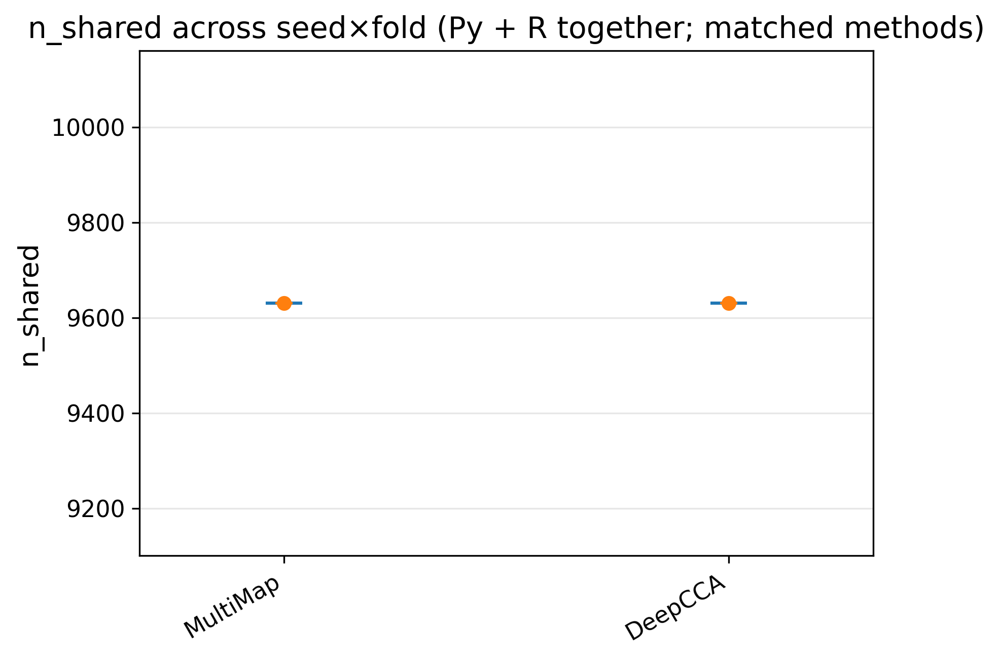

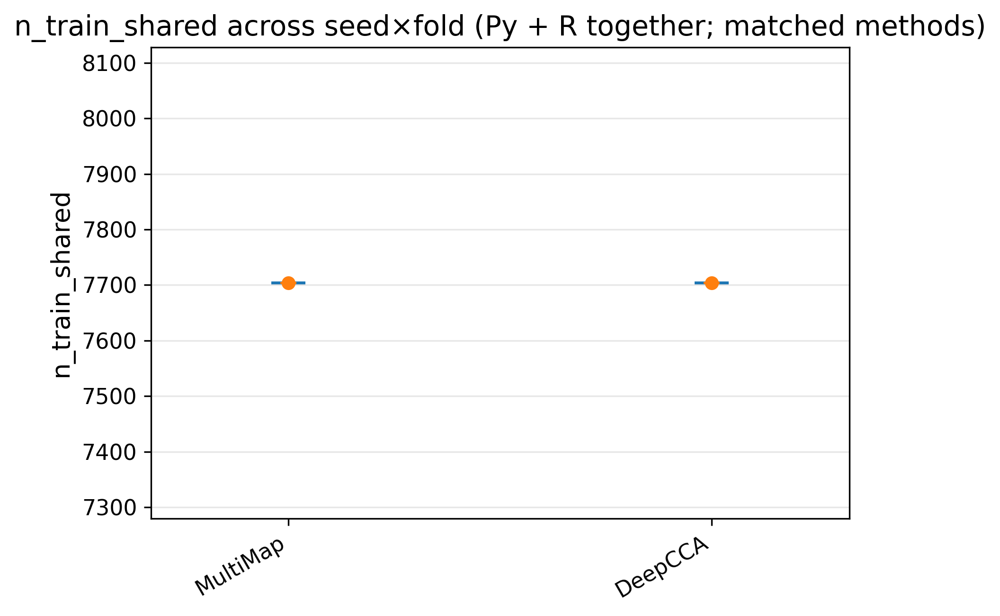

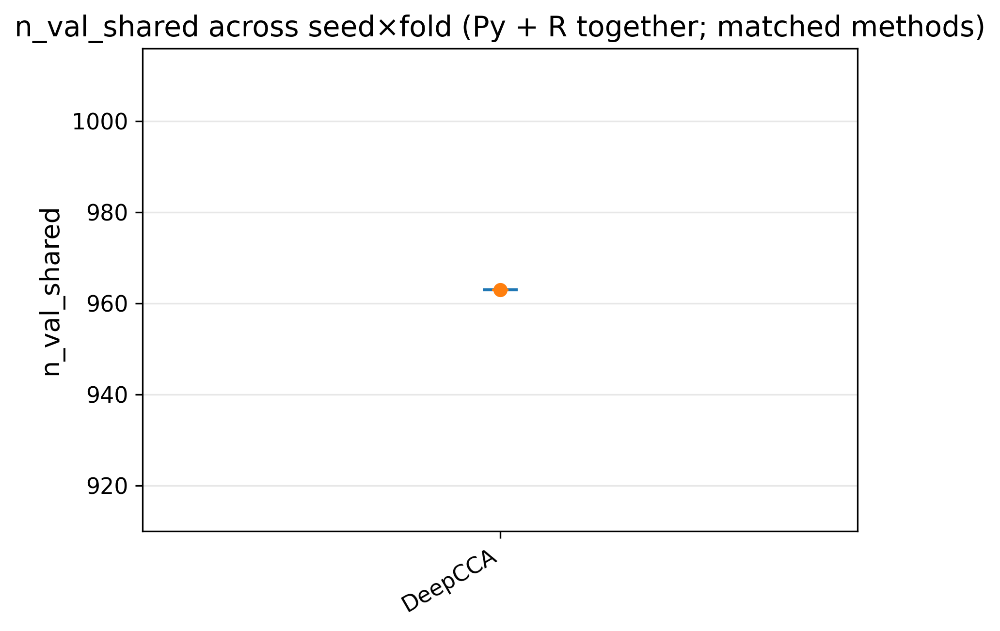

In [12]:
# -----------------------------
# Plot: matched methods per metric on the same axis/order
# -----------------------------
def violin_metric_matched(
    df_plot_long: pd.DataFrame,
    metric: str,
    *,
    method_order: list[str],
    title: str | None = None,
    savepath: str | Path | None = None,
    figsize_base=(6, 4.5),
    min_n: int = 1,
):
    dd = df_plot_long[df_plot_long["metric"] == metric].copy()
    if dd.empty:
        print(f"[plot] no data for metric={metric}")
        return

    counts = dd.groupby("method")["value"].size()
    keep_methods = counts[counts >= min_n].index.tolist()
    dd = dd[dd["method"].isin(keep_methods)]
    if dd.empty:
        print(f"[plot] no methods with >= {min_n} points for metric={metric}")
        return

    present = list(pd.unique(dd["method"]))
    order_use = [m for m in method_order if m in present] + [m for m in present if m not in method_order]

    data = [dd.loc[dd["method"] == m, "value"].to_numpy(dtype=float) for m in order_use]
    means = np.array([np.mean(x) for x in data], dtype=float)
    sems  = np.array([np.std(x, ddof=1) / np.sqrt(len(x)) if len(x) > 1 else np.nan for x in data], dtype=float)
    medians = np.array([np.median(x) for x in data], dtype=float)

    fig_w = max(figsize_base[0], 0.85 * len(order_use))
    fig, ax = plt.subplots(figsize=(fig_w, figsize_base[1]))

    ax.violinplot(
        data,
        positions=np.arange(1, len(order_use) + 1),
        showmeans=False,
        showextrema=False,
        showmedians=False,
    )

    xs = np.arange(1, len(order_use) + 1)
    ax.errorbar(xs, means, yerr=sems, fmt="o", capsize=4, linewidth=1.5)
    ax.scatter(xs, medians, marker="_", s=300)

    ax.set_xticks(xs)
    ax.set_xticklabels(order_use, rotation=30, ha="right")
    ax.set_ylabel(metric)
    ax.set_title(title or f"{metric} (matched methods on same plot)")
    ax.grid(True, axis="y", alpha=0.3)
    fig.tight_layout()

    if savepath is not None:
        savepath = Path(savepath)
        savepath.parent.mkdir(parents=True, exist_ok=True)
        fig.savefig(savepath, dpi=200, bbox_inches="tight")

    plt.show()

for metric in metric_cols:
    violin_metric_matched(
        df_plot,
        metric,
        method_order=METHOD_ORDER_USE,
        title=f"{metric} across seed×fold (Py + R together; matched methods)",
        savepath=OUT_DIR / f"violin_matched_{metric}.png",
        min_n=1,
    )


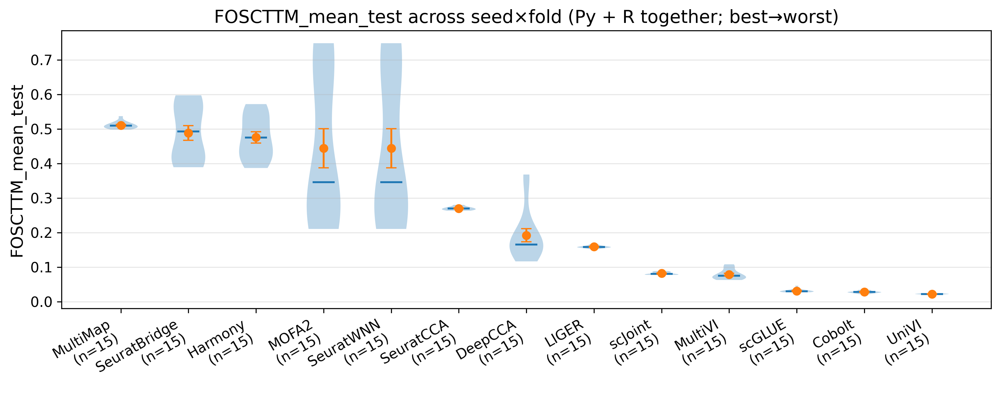

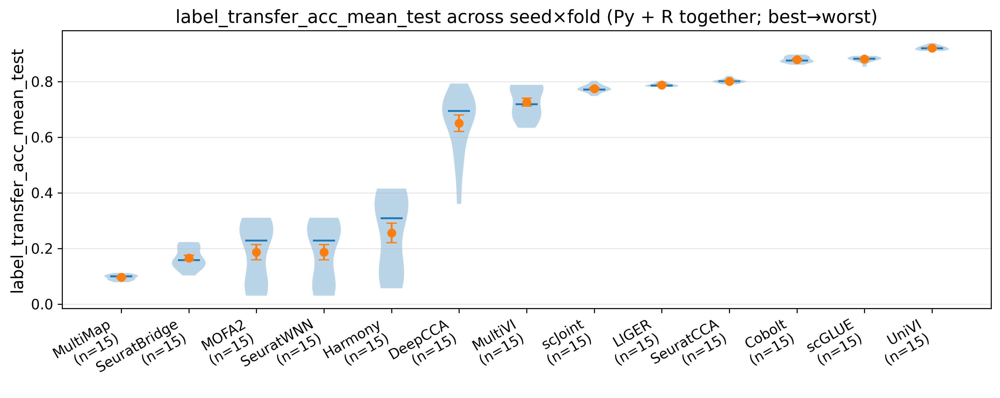

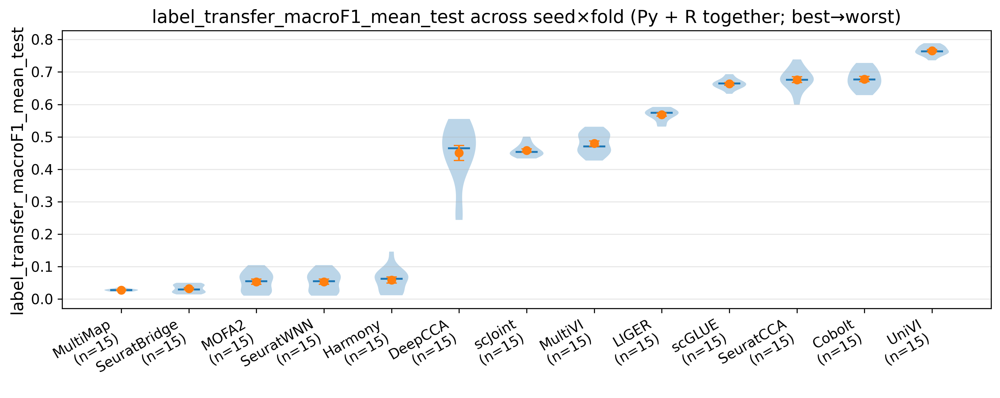

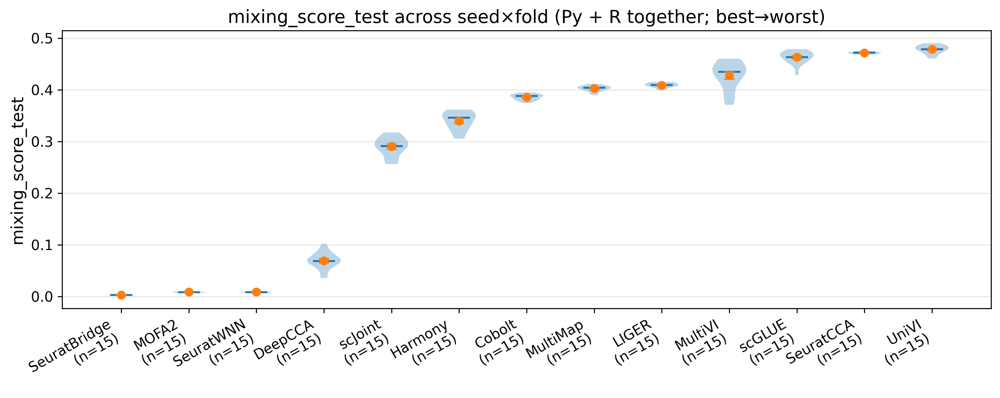

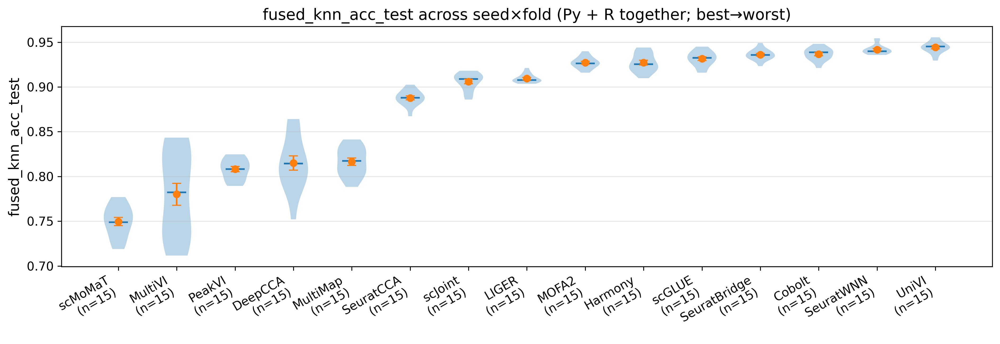

...

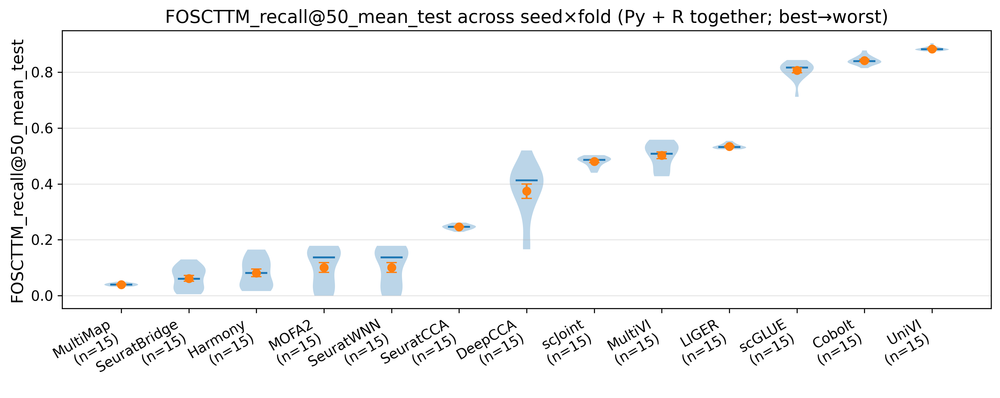

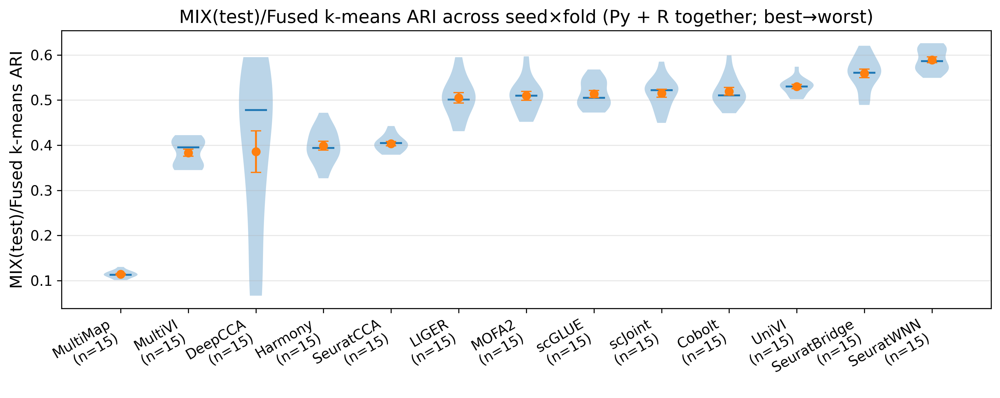

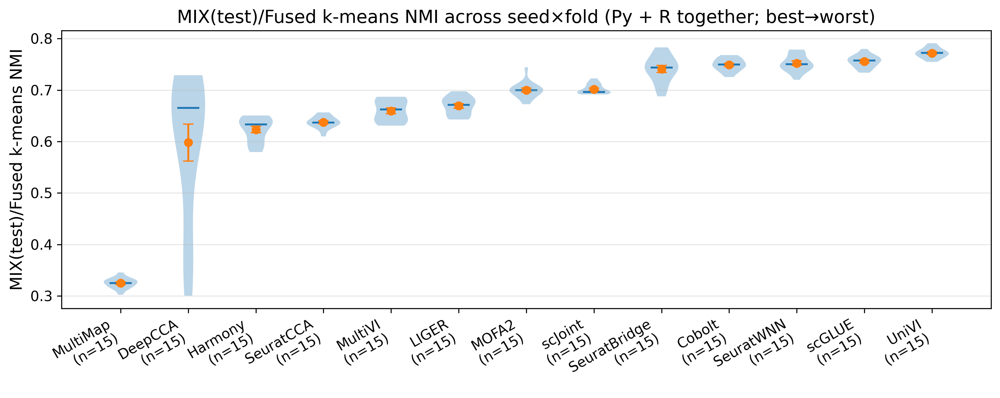

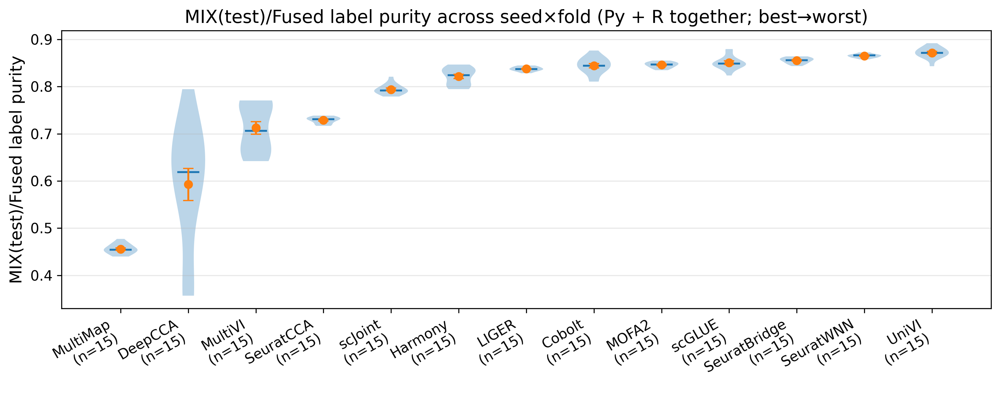

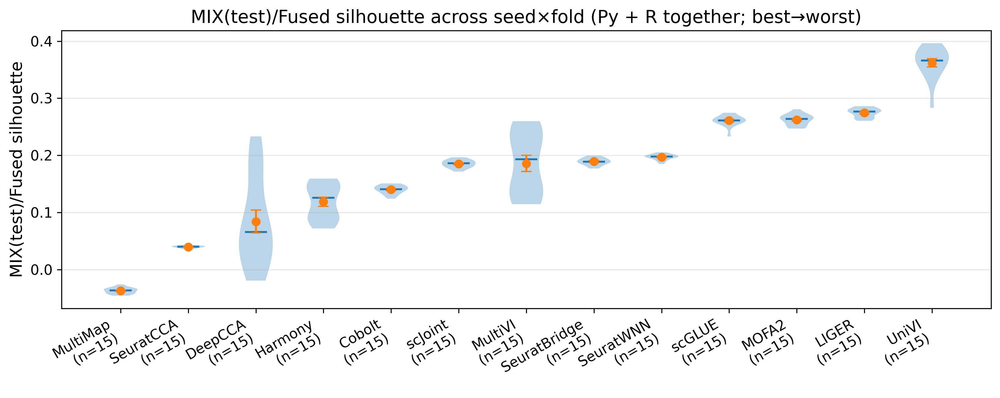

[plot] no data for metric=MIX(test)/Mixing score (ATAC)


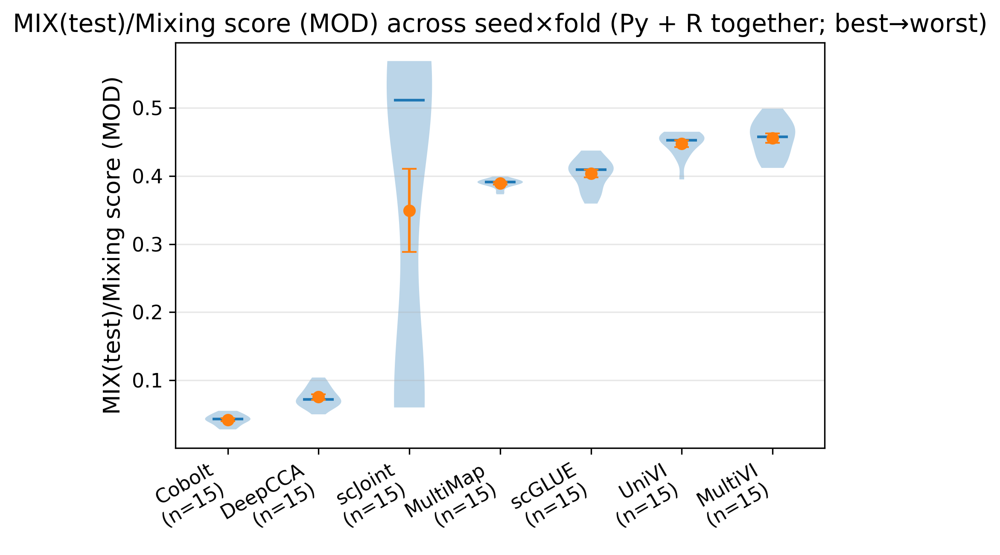

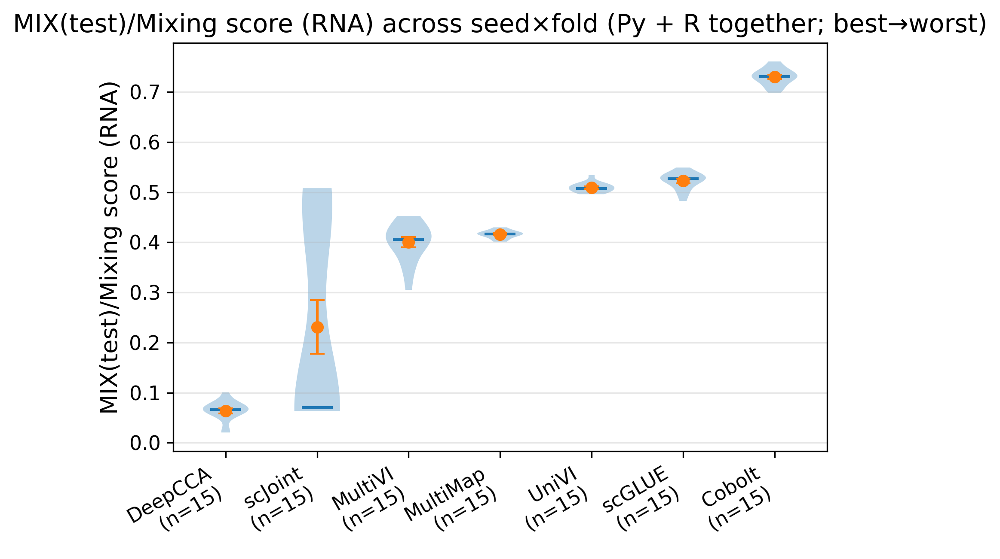

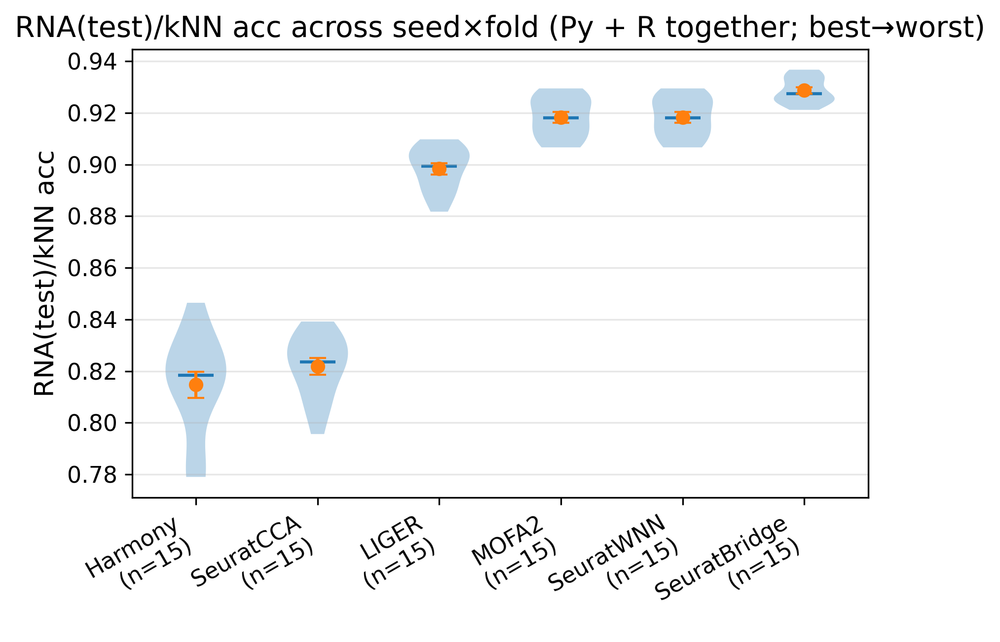

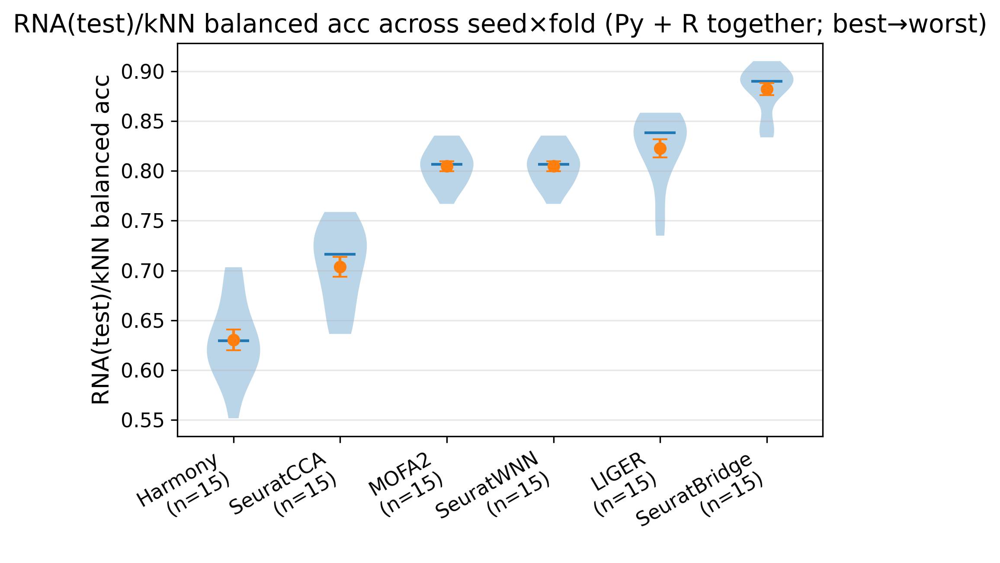

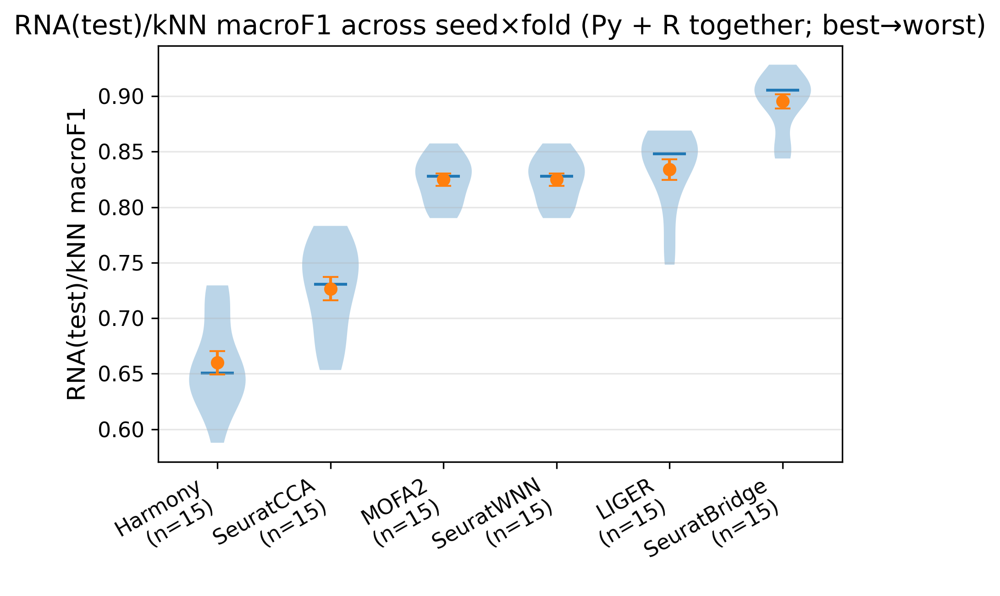

...

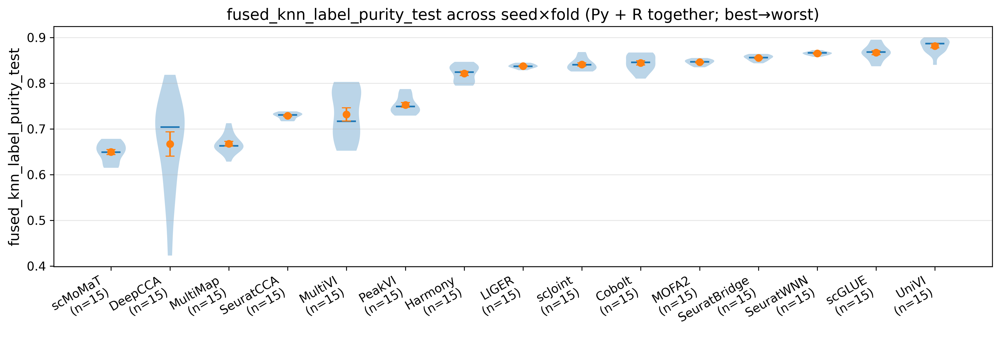

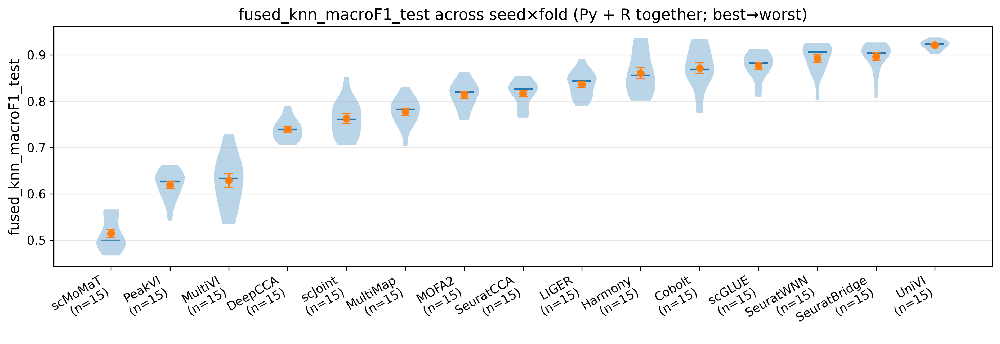

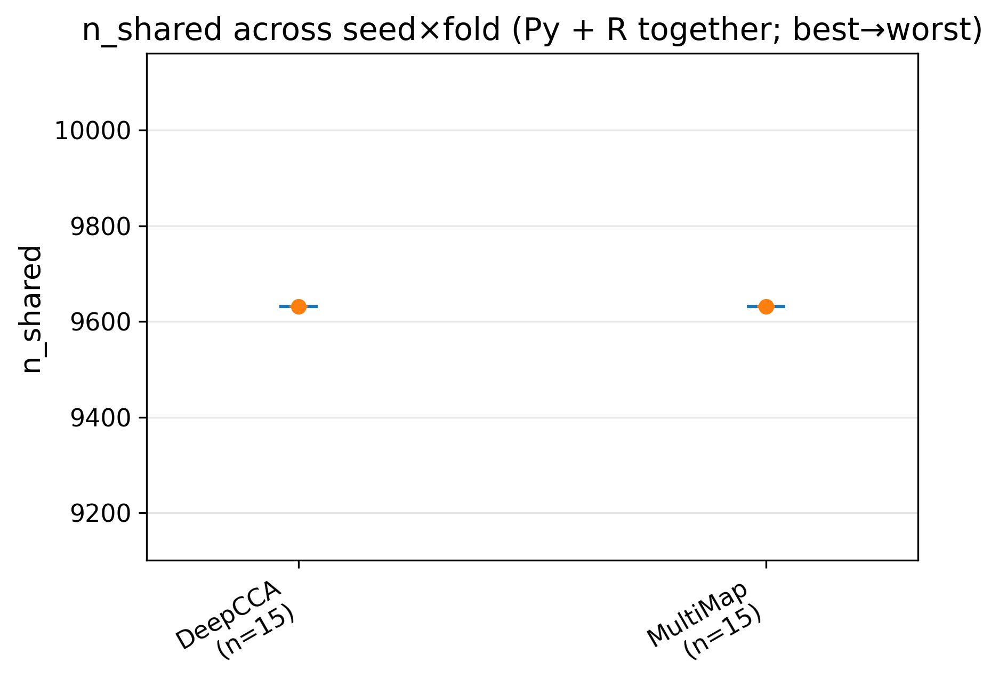

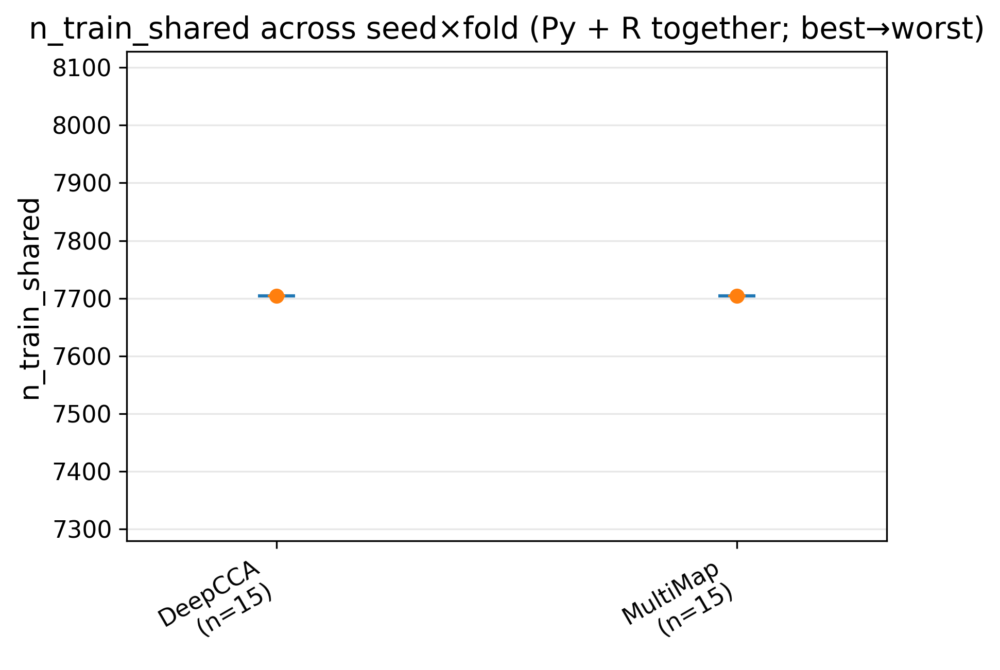

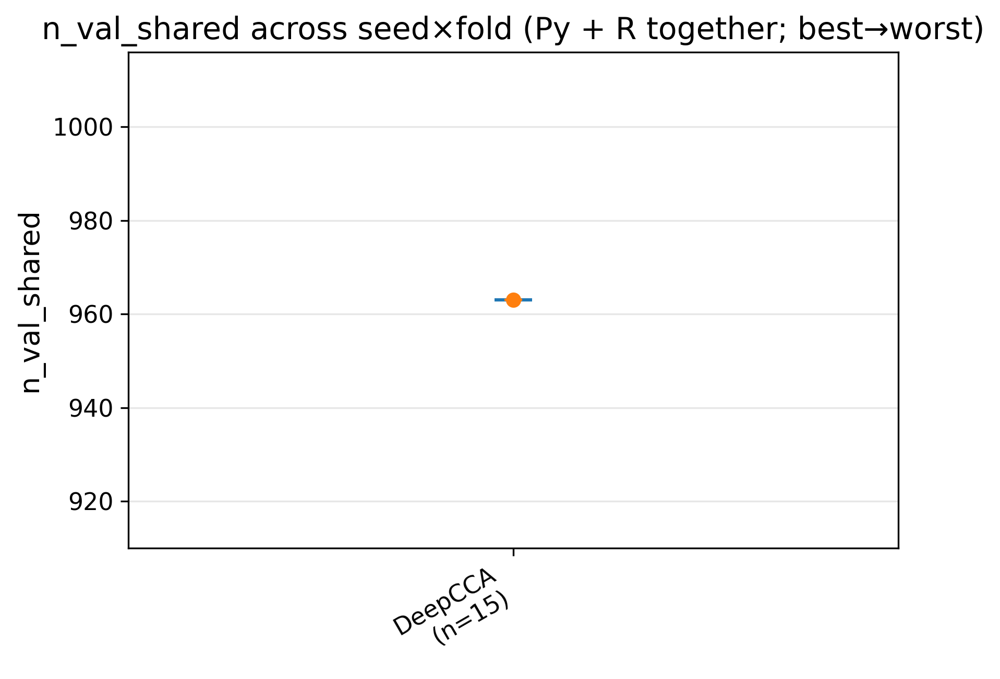

df_rank_all: (407, 6)


,method,metric,higher_is_better,mean,median,n
0,MultiMap,FOSCTTM_mean_test,False,0.510559,0.510048,15
1,SeuratBridge,FOSCTTM_mean_test,False,0.488451,0.492896,15
2,Harmony,FOSCTTM_mean_test,False,0.475744,0.475381,15
3,MOFA2,FOSCTTM_mean_test,False,0.443772,0.345389,15
4,SeuratWNN,FOSCTTM_mean_test,False,0.443772,0.345389,15
5,SeuratCCA,FOSCTTM_mean_test,False,0.269959,0.269676,15
6,DeepCCA,FOSCTTM_mean_test,False,0.192215,0.165428,15
7,LIGER,FOSCTTM_mean_test,False,0.158657,0.157810,15
8,scJoint,FOSCTTM_mean_test,False,0.081557,0.079855,15
9,MultiVI,FOSCTTM_mean_test,False,0.078612,0.074966,15


In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# -----------------------------
# Utility: decide direction automatically (overrideable)
# -----------------------------
def _infer_higher_is_better(metric_name: str) -> bool:
    """
    Heuristic:
      - FOSCTTM_mean: lower is better
      - loss/error/dist/etc: usually lower is better
      - otherwise assume higher is better
    """
    m = str(metric_name).lower()
    if "foscttm_mean" in m:
        return False
    if any(k in m for k in ["loss", "error", "distance", "dist", "rmse", "mse"]):
        return False
    return True

# -----------------------------
# Plot: best -> worst (per metric) across both sources
# -----------------------------
def violin_metric_best_to_worst(
    df_plot_long: pd.DataFrame,
    metric: str,
    *,
    title: str | None = None,
    savepath: str | Path | None = None,
    figsize_base=(6, 4.5),
    agg: str = "mean",               # "mean" or "median" for sorting
    higher_is_better: bool | None = None,
    min_n: int = 1,                  # drop methods with < min_n obs for this metric
    tie_breaker: str = "median",     # used when agg="mean" and means tie closely
    tie_eps: float = 1e-12,
    show_n_in_labels: bool = True,
):
    dd = df_plot_long[df_plot_long["metric"] == metric].copy()
    if dd.empty:
        print(f"[plot] no data for metric={metric}")
        return None

    # robust numeric conversion
    dd["value"] = pd.to_numeric(dd["value"], errors="coerce")
    dd = dd.dropna(subset=["value", "method"])
    if dd.empty:
        print(f"[plot] no numeric data for metric={metric}")
        return None

    # counts + filter
    gb = dd.groupby("method")["value"]
    counts = gb.size()
    keep = counts[counts >= min_n].index
    dd = dd[dd["method"].isin(keep)]
    if dd.empty:
        print(f"[plot] no methods with >= {min_n} points for metric={metric}")
        return None

    gb = dd.groupby("method")["value"]
    means = gb.mean()
    medians = gb.median()

    # pick scoring function for ordering
    if agg == "mean":
        score = means.copy()
        # optional tie-breaker
        if tie_breaker == "median":
            # stable-ish: sort by mean, then median
            score_tbl = pd.DataFrame({"mean": means, "median": medians, "n": gb.size()})
        else:
            score_tbl = pd.DataFrame({"mean": means, "median": medians, "n": gb.size()})
    elif agg == "median":
        score = medians.copy()
        score_tbl = pd.DataFrame({"median": medians, "mean": means, "n": gb.size()})
    else:
        raise ValueError("agg must be 'mean' or 'median'")

    if higher_is_better is None:
        higher_is_better = _infer_higher_is_better(metric)

    # sort best -> worst
    ascending = not higher_is_better

    # sort worst -> best
    #ascending = higher_is_better

    if agg == "mean":
        # sort by mean, then median as a deterministic tie-breaker
        score_tbl = score_tbl.sort_values(
            by=["mean", "median"] if higher_is_better else ["mean", "median"],
            ascending=[ascending, ascending],
        )
        # If you want “real” tie detection:
        # (kept simple; the sort above already gives deterministic ordering)
        order_use = score_tbl.index.tolist()
    else:
        # sort by median, then mean as tie-breaker
        score_tbl = score_tbl.sort_values(
            by=["median", "mean"],
            ascending=[ascending, ascending],
        )
        order_use = score_tbl.index.tolist()

    # gather per-method arrays in that order
    data = [dd.loc[dd["method"] == m, "value"].to_numpy(dtype=float) for m in order_use]

    # compute summary stats for errorbars/markers
    mean_vals = np.array([np.mean(x) for x in data], dtype=float)
    sem_vals  = np.array([np.std(x, ddof=1) / np.sqrt(len(x)) if len(x) > 1 else np.nan for x in data], dtype=float)
    med_vals  = np.array([np.median(x) for x in data], dtype=float)

    # x tick labels (optionally annotate n)
    if show_n_in_labels:
        ns = score_tbl.loc[order_use, "n"].to_numpy()
        xticklabels = [f"{m}\n(n={int(n)})" for m, n in zip(order_use, ns)]
    else:
        xticklabels = order_use

    # figure
    fig_w = max(figsize_base[0], 0.85 * len(order_use))
    fig, ax = plt.subplots(figsize=(fig_w, figsize_base[1]))

    ax.violinplot(
        data,
        positions=np.arange(1, len(order_use) + 1),
        showmeans=False,
        showextrema=False,
        showmedians=False,
    )

    xs = np.arange(1, len(order_use) + 1)
    ax.errorbar(xs, mean_vals, yerr=sem_vals, fmt="o", capsize=4, linewidth=1.5)
    ax.scatter(xs, med_vals, marker="_", s=300)

    direction = "higher=better" if higher_is_better else "lower=better"
    ax.set_xticks(xs)
    ax.set_xticklabels(xticklabels, rotation=30, ha="right")
    ax.set_ylabel(metric)
    ax.set_title(title or f"{metric} (best→worst by {agg}; {direction})")
    ax.grid(True, axis="y", alpha=0.3)
    fig.tight_layout()

    if savepath is not None:
        savepath = Path(savepath)
        savepath.parent.mkdir(parents=True, exist_ok=True)
        fig.savefig(savepath, dpi=200, bbox_inches="tight")

    plt.show()

    # return ranking table (for reporting)
    out = score_tbl.copy()
    out.insert(0, "method", out.index)
    out = out.reset_index(drop=True)
    out.insert(1, "metric", metric)
    out.insert(2, "higher_is_better", higher_is_better)
    return out


# -----------------------------
# Run for all metrics (save plots + collect rankings)
# -----------------------------
rank_tables = []
for metric in metric_cols:
    rank = violin_metric_best_to_worst(
        df_plot,
        metric,
        agg="mean",                       # or "median"
        higher_is_better=None,            # auto; override if you want
        min_n=1,
        title=f"{metric} across seed×fold (Py + R together; best→worst)",
        savepath=OUT_DIR / f"violin_best-to-worst_{metric}.png",
        show_n_in_labels=True,
    )
    if rank is not None:
        rank_tables.append(rank)

df_rank_all = pd.concat(rank_tables, ignore_index=True) if rank_tables else pd.DataFrame()
print("df_rank_all:", df_rank_all.shape)
display(df_rank_all.head(20))
